# Spotify Exploratory Data Analysis and Recommendation System

Today, Spotify is the world's most popular audio streaming subscription service with 433m active users, including 188m subscribers, across 183 markets. <p>
    
We will perform Exploratory Data Analysis (EDA) in Python using Pandas, NumPy, Matplotlib, and Seaborn on Spotify’s dataset, such as sampling, correlation, etc.to identify missing values, plots, correlation heat map. <p>

Will explore and quantify the music data to gain insights and correlations among the diiferent song attributes using heatmap and regression plots with Python libraries and functions. 

After the EDA we will built a Music Recommendation System using different the Spotify dataset.   

<img src="https://storage.googleapis.com/pr-newsroom-wp/1/2018/11/Spotify_Logo_RGB_Green-768x231.png" width="450" align="left"/>

### Importing Libraries

In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
#%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

### Reading Spotify Dataset

In [2]:
data = pd.read_csv("D:/DATA ANALYST PROJECTS/Spotify EDA and Recommendation System/Dataset/data.csv")
genre_data = pd.read_csv("D:/DATA ANALYST PROJECTS/Spotify EDA and Recommendation System/Dataset/data_by_genres.csv")
year_data = pd.read_csv("D:/DATA ANALYST PROJECTS/Spotify EDA and Recommendation System/Dataset/data_by_year.csv")
artist_data = pd.read_csv("D:/DATA ANALYST PROJECTS/Spotify EDA and Recommendation System/Dataset/data_by_artist.csv")

In [3]:
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [4]:
genre_data.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [5]:
year_data.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [6]:
artist_data.head()

,mode,count,acousticness,artists,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,9,0.590111,"""Cats"" 1981 Original London Cast",0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5
1,1,26,0.862538,"""Cats"" 1983 Broadway Cast",0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,30.576923,5
2,1,7,0.856571,"""Fiddler On The Roof” Motion Picture Chorus",0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.857143,0
3,1,27,0.884926,"""Fiddler On The Roof” Motion Picture Orchestra",0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.851852,0
4,1,7,0.510714,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,43.000000,5


In [7]:
# checking size of data

data.shape

(170653, 19)

In [8]:
# checking null value

pd.isnull(data).sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
dtype: int64

In [9]:
# concise summary of the DataFrame

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [10]:
# concise summary of the DataFrame

genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [11]:
# concise summary of the DataFrame

year_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [12]:
# concise summary of the DataFrame

artist_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              28680 non-null  int64  
 1   count             28680 non-null  int64  
 2   acousticness      28680 non-null  float64
 3   artists           28680 non-null  object 
 4   danceability      28680 non-null  float64
 5   duration_ms       28680 non-null  float64
 6   energy            28680 non-null  float64
 7   instrumentalness  28680 non-null  float64
 8   liveness          28680 non-null  float64
 9   loudness          28680 non-null  float64
 10  speechiness       28680 non-null  float64
 11  tempo             28680 non-null  float64
 12  valence           28680 non-null  float64
 13  popularity        28680 non-null  float64
 14  key               28680 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.3+ MB


In [13]:
#### Descriptive statistics of the numerical variables present in columns

data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
valence,170653.0,0.528587,0.263171,0.0,0.3170,0.540000,0.7470,1.000
year,170653.0,1976.787241,25.917853,1921.0,1956.0000,1977.000000,1999.0000,2020.000
acousticness,170653.0,0.502115,0.376032,0.0,0.1020,0.516000,0.8930,0.996
danceability,170653.0,0.537396,0.176138,0.0,0.4150,0.548000,0.6680,0.988
duration_ms,170653.0,230948.310666,126118.414668,5108.0,169827.0000,207467.000000,262400.0000,5403500.000
energy,170653.0,0.482389,0.267646,0.0,0.2550,0.471000,0.7030,1.000
explicit,170653.0,0.084575,0.278249,0.0,0.0000,0.000000,0.0000,1.000
instrumentalness,170653.0,0.167010,0.313475,0.0,0.0000,0.000216,0.1020,1.000
key,170653.0,5.199844,3.515094,0.0,2.0000,5.000000,8.0000,11.000
liveness,170653.0,0.205839,0.174805,0.0,0.0988,0.136000,0.2610,1.000


### Top10 least popular songs

In [14]:
least_popular = data.sort_values('popularity', ascending = True).head(10) 
least_popular[['year','name','release_date','artists']]

,year,name,release_date,artists
42183,1944,Meri Balam Bada Harjaee Re,1944-12-31,['Rajkumari']
21628,1934,Sin Rumbo - Remasterizado,1934-01-10,"['Francisco Canaro', 'Ernesto Fama']"
21627,1934,La Cachetada - Remasterizado,1934-01-03,"['Francisco Canaro', 'Ernesto Fama']"
21626,1934,Winter Wonderland,1934-01-01,['Véronique Flamand-Somers']
21625,1934,The Marines Hymn,1934-07-01,"['Richard Himber and his Orchestra', 'Guy Russ..."
21624,1934,Tomar Ankhir Pare,1934-12-01,['Sabita Singha']
21623,1934,Vieni Vieni,1934,['Tino Rossi']
21621,1934,Fête du 14 juillet et Final (From Hôtel du Nor...,1934-01-01,['Maurice Jaubert']
21620,1934,The Last Round Up,1934-07-01,"['Richard Himber and his Orchestra', 'Joey Nash']"
21619,1934,Negrita de Mi Alma - Remasterizado,1934-01-10,"['Francisco Canaro', 'Ernesto Fama']"


### Top10 most popular songs

In [15]:
most_popular = data.sort_values('popularity', ascending = False).head(10) 
most_popular[['year','name','release_date','artists']]

,year,name,release_date,artists
19611,2020,Dakiti,2020-10-30,"['Bad Bunny', 'Jhay Cortez']"
19606,2020,Mood (feat. iann dior),2020-07-24,"['24kGoldn', 'iann dior']"
19618,2020,Dynamite,2020-08-28,['BTS']
19608,2020,WAP (feat. Megan Thee Stallion),2020-08-07,"['Cardi B', 'Megan Thee Stallion']"
19610,2020,positions,2020-10-30,['Ariana Grande']
19612,2020,What You Know Bout Love,2020-07-03,['Pop Smoke']
19616,2020,Blinding Lights,2020-03-20,['The Weeknd']
19607,2020,For The Night (feat. Lil Baby & DaBaby),2020-07-03,"['Pop Smoke', 'Lil Baby', 'DaBaby']"
19615,2020,Holy (feat. Chance The Rapper),2020-09-18,"['Justin Bieber', 'Chance the Rapper']"
19620,2020,Lonely (with benny blanco),2020-10-16,"['Justin Bieber', 'benny blanco']"


### Top10 most popular artists (not based on monthly listeners)

One might mistake this as the monthly listeners but it's a different.The higher your popularity index, the more likely the algorithm is to recommend you to new listeners, and place you in algorithmic playlists like Release Radar and Discover Weekly.

In [16]:
popular_artists = artist_data.sort_values('popularity', ascending=False).head(10)
popular_artists[['popularity','energy','artists','danceability']]

,popularity,energy,artists,danceability
20966,93.0,0.491,Ritt Momney,0.399000
14354,92.0,0.686,Lele Pons,0.905000
15070,90.0,0.821,Los Legendarios,0.823000
11764,89.0,0.525,Jerry Di,0.854000
28263,88.0,0.621,salem ilese,0.738000
23687,88.0,0.774,Surf Mesa,0.674000
7463,88.0,0.774,Emilee,0.674000
213,87.0,0.726,A7S,0.742667
26318,86.0,0.669,Towy,0.863000
16453,86.0,0.483,Master KG,0.880000


#### Converting song duration from milliseconds to minutes

In [17]:
data['duration']=data['duration_ms'].apply(lambda x : round((x/60000),2))
genre_data['duration']=genre_data['duration_ms'].apply(lambda x : round((x/60000),2))
year_data['duration']=year_data['duration_ms'].apply(lambda x : round((x/60000),2))
artist_data['duration']=artist_data['duration_ms'].apply(lambda x : round((x/60000),2))
data.duration.head()

0    13.86
1     3.01
2     8.33
3     3.50
4     2.78
Name: duration, dtype: float64

### Visualizing through a correlation map

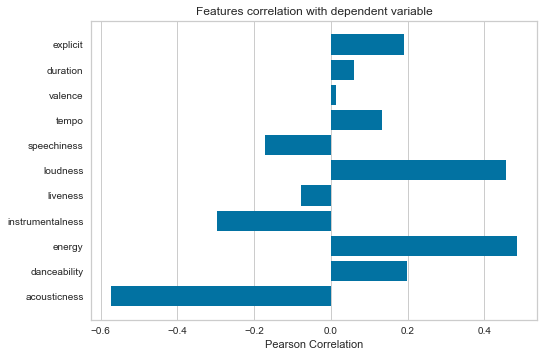

In [18]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration','explicit']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show();        # Finalize and render the figure

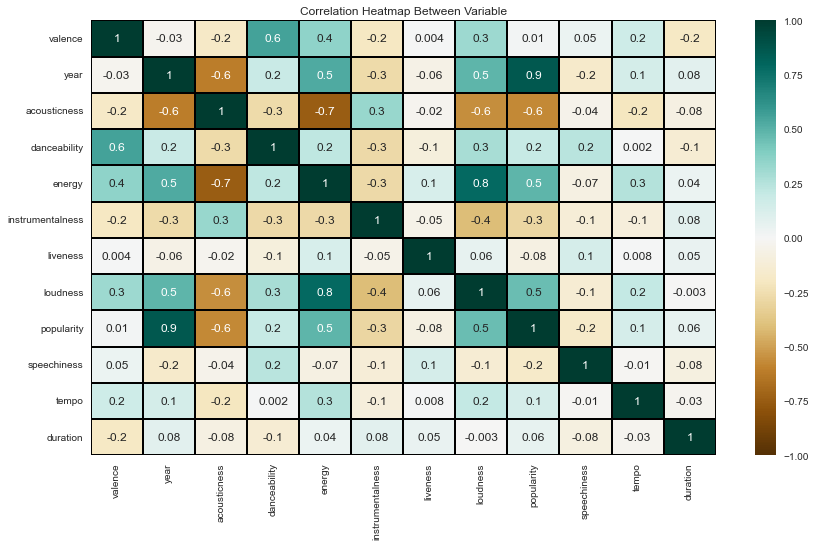

In [19]:
corr_df=data.drop(['key','mode','explicit','duration_ms'], axis=1).corr(method='pearson')
plt.figure(figsize=(14,8))
heatmap=sns.heatmap(corr_df, annot=True, fmt='.1g', vmin=-1, vmax=1, center=0, cmap="BrBG", linewidths=2, linecolor="Black"
)
heatmap.set_title('Correlation Heatmap Between Variable')
heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=90);

### Regression plot between Loudness and Energy

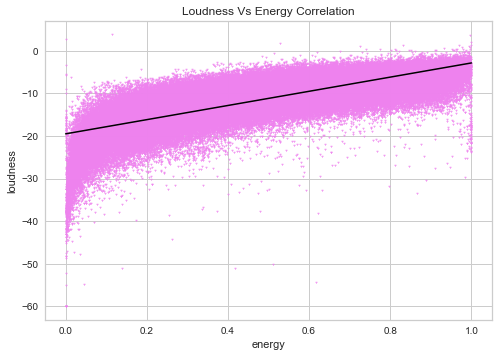

In [20]:
sns.regplot(data=data, y='loudness', x='energy', scatter_kws={"color": "violet", 's':2}, marker='2', line_kws={"color": "black", 'linewidth':1.5}).set(title='Loudness Vs Energy Correlation');

### Regression plot between Popularity and Acousticness

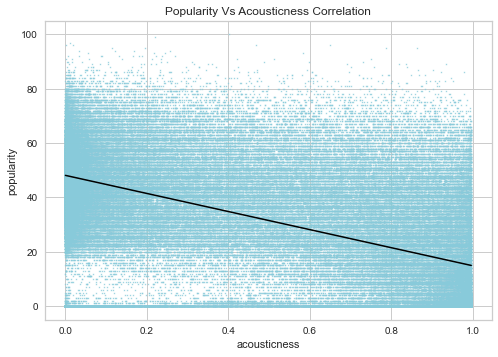

In [21]:
sns.regplot(data=data, y='popularity', x='acousticness', scatter_kws={"color": "c", 's':3}, marker='X', line_kws={"color": "black", 'linewidth':1.5}).set(title='Popularity Vs Acousticness Correlation');

### Regression plot between Speechiness and Acousticness

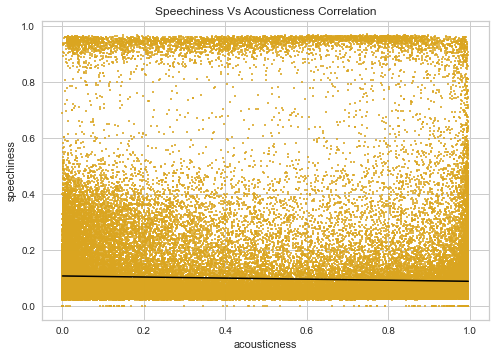

In [22]:
sns.regplot(data=data, y='speechiness', x='acousticness', scatter_kws={"color": "goldenrod", 's':3}, marker='+', line_kws={"color": "black", 'linewidth':1.5}).set(title='Speechiness Vs Acousticness Correlation');

### Regression plot between Popularity and Danceability

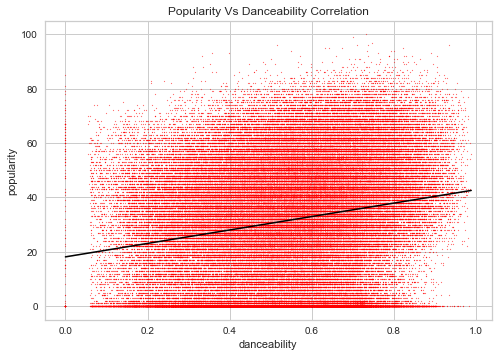

In [23]:
sns.regplot(data=data, y='popularity', x='danceability', scatter_kws={"color": "red", 's':3}, marker='*', line_kws={"color": "black", 'linewidth':1.5}).set(title='Popularity Vs Danceability Correlation');

### Bar plot to visualize the correlation between the duration of songs and their different genres


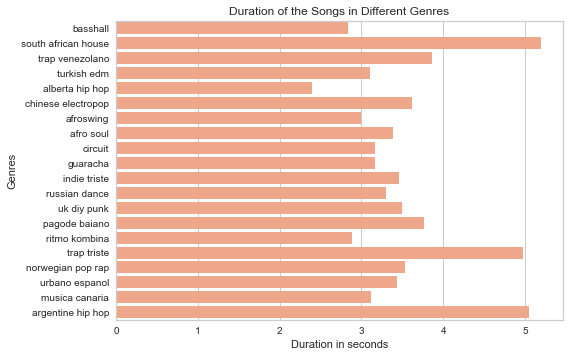

In [24]:
top_genres = genre_data.nlargest(20, 'popularity')
plt.title("Duration of the Songs in Different Genres")
#sns.color_palette("rocket", as_cmap= True)
sns.barplot(y='genres', x='duration', data=top_genres, color='lightsalmon')
plt.xlabel ("Duration in seconds")
plt.ylabel("Genres");

## *Music Over Time*

### Bar plot to visualize the duration of songs over the years

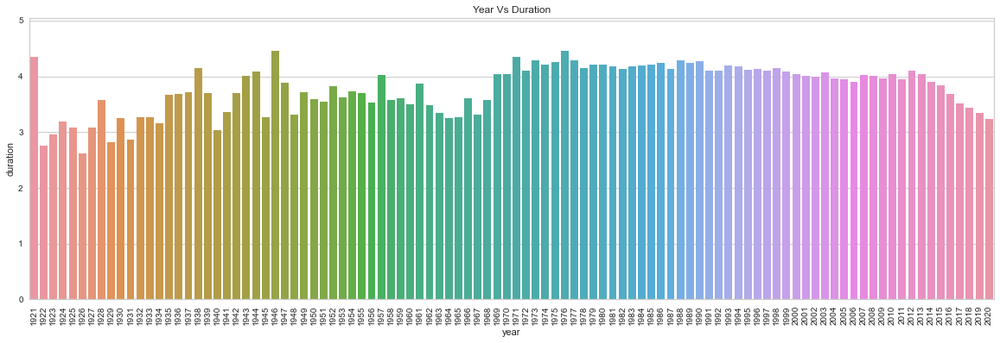

In [25]:
plt.figure(figsize=(20,6))
sns.barplot(x="year",y="duration", errwidth=False, data=data).set(title='Year Vs Duration')
plt.xticks(rotation=90);

### Distribution plot to visualize the total number of songs in each year since 1921 in our Spotify database

In [26]:
fig = px.histogram(data, x="year")
fig.show()

### *How the overall sound of music has changed from 1921 to 2020...*

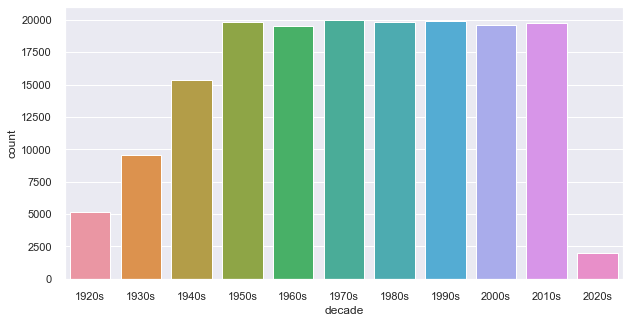

In [27]:
def extract_decade(year):
    start_period = int(year/10) * 10
    decade = '{}s'.format(start_period)
    return decade

data['decade'] = data['year'].apply(extract_decade)

sns.set(rc={'figure.figsize':(10 ,5)})
sns.countplot(data['decade']);

In [28]:
sound_features = ['acousticness', 'liveness', 'instrumentalness', 'energy', 'danceability', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

### Characteristics of various genres over the years
Using the audio features for different genres we can compare them and their unique differences in music.

In [29]:
top_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

### Clustering Genres with K-Means

Using simple K-means clustering algorithm to divide the genres in this dataset into ten clusters based on the numerical audio features of each genres.

In [30]:
from sklearn.cluster import KMeans
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [31]:
# Visualizing the Clusters with t-SNE


from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=False))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show();

### Clustering Songs with K-Means

In [32]:
number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=20, verbose=False))], verbose=False)

X = data[number_cols].select_dtypes(np.number)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [33]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show();

### Building the Recommendation System

Based on the analysis and visualizations, it’s clear that similar genres tend to have data points that are located close to each other while similar types of songs are also clustered together.

This observation makes perfect sense. Similar genres will sound similar and will come from similar time periods while the same can be said for songs within those genres. 

We can use this idea to build a recommendation system by taking the data points of the songs a user has listened to and then recommending songs corresponding to nearby data points.

We will use Spotipy. It is a Python client for the Spotify Web API that makes it easy for developers to fetch data and query Spotify’s catalog for songs.

In [34]:
!pip install spotipy

Defaulting to user installation because normal site-packages is not writeable


In [35]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="88f16ab0579f46e68276b5ea6febf994", 
                                                           client_secret="577807c725b74c649817aa6c9eb926de"))

def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [36]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

#### Recommended Songs:

In [37]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                 {'name': 'All Apologies', 'year': 1993},
                  {'name': 'Stay Away', 'year': 1993}], data)

[{'name': 'Life is a Highway - From "Cars"',
  'year': 2009,
  'artists': "['Rascal Flatts']"},
 {'name': 'Of Wolf And Man', 'year': 1991, 'artists': "['Metallica']"},
 {'name': 'Somebody Like You', 'year': 2002, 'artists': "['Keith Urban']"},
 {'name': 'Corazón Mágico', 'year': 1995, 'artists': "['Los Fugitivos']"},
 {'name': 'Kayleigh', 'year': 1992, 'artists': "['Marillion']"},
 {'name': 'Little Secrets', 'year': 2009, 'artists': "['Passion Pit']"},
 {'name': "Let's Get Rocked", 'year': 1992, 'artists': "['Def Leppard']"},
 {'name': 'No Excuses', 'year': 1994, 'artists': "['Alice In Chains']"},
 {'name': 'If Today Was Your Last Day',
  'year': 2008,
  'artists': "['Nickelback']"},
 {'name': "Things I'll Never Say",
  'year': 2002,
  'artists': "['Avril Lavigne']"}]